# Siamese Networks For Image Verification

Written by Raafi Rahman in Google Colab

## Things to do and questions to answer

1. How does the training work (in terms of anchors and positives)?
    
  See document.

2. Why manhattan distance when comparing the embedded vectors?



3. Why binary cross entropy?

  There are ultimately 2 choices the model can make. We want the model to tell us that an inout image is a match or not a match. Thus with two choices binary cross entropy works in our case. Contrastive Loss is esentially a modified version of Cross Entropy Loss

4. How to pick the threshold value for the classification?

  On hold

5. What are the alternative deep learning models for face recognition?

  A popular alternative to using Siamese Networks was the use of the Eigenfaces algorithm where Linear Algebra and Principal Component Analysis is heavily used.

6. What does the batch normalization do?



8. What is contrastive loss and how does it work?

    ```
    def contrastive_loss(y_true, y_pred):
      # y_true is either 0 or 1. 0 is not a match or 1 is it is a match.
      # y_pred is the prediction made by the model (somewhere from 0 to 1)

      square_pred = tf.math.square(y_pred) # Ls
      margin_square = tf.math.square(tf.math.maximum(1 - (y_pred), 0)) # Ld
      
      return(tf.math.reduce_mean(
        (1 - y_true) * square_pred + (y_true) * margin_square
      ))
    ```
  
  $$L = (1 - y_{\textrm{true}}) * L_{\textrm{s}}(y_{\textrm{pred}}) + y_{\textrm{true}} * L_{\textrm{d}}(y_{\textrm{pred}})$$

  http://yann.lecun.com/exdb/publis/pdf/hadsell-chopra-lecun-06.pdf

  Contrastive loss takes the predicted output and the true output. Depending on whether the true output is one thing or the other, one term in the function activates and the other is multiplied by 0, canceling it out. In either case, if the prediction is close to the true value, the loss added is minimal. If the prediction is not close to the actual, then the loss added is larger. This is summed up and the final loss is returned.

9. Number of epochs?

  On hold

10. How to adjust the hyperparameters, possibly using validation data (like the threshold value in the last sigmoid layer, as in if pred > x then true)?



11. siamese networks: How to make training data? how imbalanced the (training) data set should be (ratio of positive vs negative matches)



12. why val accuracy doesn't change? 
    https://stackoverflow.com/questions/52356068/validation-accuracy-constant-in-keras-cnn-for-multiclass-image-classification



13. find a scenario where one of accuracy, recall, precision or f1 is to be used. do it for all four. What should our classification matrix be?
    https://en.wikipedia.org/wiki/Confusion_matrix
    https://towardsdatascience.com/accuracy-precision-recall-or-f1-331fb37c5cb9




## Imports

In [1]:
# Machine Learning libraries
import sklearn
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split

import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Layer, Conv2D, Dense, MaxPooling2D, Input, Flatten, Lambda, BatchNormalization, Dropout

from functools import partial

# Load data
from google.colab import drive
drive.mount('/content/drive')

# Common imports
import numpy as np
import matplotlib.pyplot as plt
import os
import cv2
import random
import gc

# Set seeds
np.random.seed(305) # 305 is last 3 digits of EMPLID
tf.random.set_seed(305)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
# Function used to plot pairs of images
def plotPair(data, index):

  fig, ax = plt.subplots(1,2)
  ax[0].imshow(data[index][0])
  ax[1].imshow(data[index][1])

## Data

#### Load Faces

In [3]:
dim = 128 # Desired length of side of image

In [4]:
posFolder = "/content/drive/MyDrive/Colab Notebooks/Case Seminar/Data/FinalFaces/positive"
negFolder = "/content/drive/MyDrive/Colab Notebooks/Case Seminar/Data/FinalFaces/negative"

In [5]:
len(os.listdir(posFolder))

5062

In [6]:
len(os.listdir(negFolder))

5062

In [7]:
pairs = []

for pair in os.listdir(posFolder):

  pairPath = os.path.join(posFolder, pair)

  img1 = cv2.imread(os.path.join(pairPath, os.listdir(pairPath)[0]))
  img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
  img1 = cv2.resize(img1, (dim, dim), interpolation = cv2.INTER_AREA)/255

  img2 = cv2.imread(os.path.join(pairPath, os.listdir(pairPath)[1]))
  img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
  img2 = cv2.resize(img2, (dim, dim), interpolation = cv2.INTER_AREA)/255
  pairs.append([img1, img2, 1])

'''
    # Data Augmentation 1
    img1flip = tf.image.flip_left_right(img1) #np.atleast_3d(img1)
    img2flip = tf.image.flip_left_right(img2)
    img1flip = tf.image.random_contrast(img1flip, .7, 1.3)
    img2flip = tf.image.random_contrast(img2flip, .7, 1.3)
    pairs.append([img2flip, img1flip, 1])

    # Data Augmentation 2
    img1con = tf.image.random_contrast(img1, .7, 1.3)
    img2con = tf.image.random_contrast(img2, .7, 1.3)
    pairs.append([img2con, img1con, 1]) #np.squeeze(img2con, axis = 2), np.squeeze(img1con, axis = 2)'''


'\n    # Data Augmentation 1\n    img1flip = tf.image.flip_left_right(img1) #np.atleast_3d(img1)\n    img2flip = tf.image.flip_left_right(img2)\n    img1flip = tf.image.random_contrast(img1flip, .7, 1.3)\n    img2flip = tf.image.random_contrast(img2flip, .7, 1.3)\n    pairs.append([img2flip, img1flip, 1])\n\n    # Data Augmentation 2\n    img1con = tf.image.random_contrast(img1, .7, 1.3)\n    img2con = tf.image.random_contrast(img2, .7, 1.3)\n    pairs.append([img2con, img1con, 1]) #np.squeeze(img2con, axis = 2), np.squeeze(img1con, axis = 2)'

In [8]:
for pair in os.listdir(negFolder):

  pairPath = os.path.join(negFolder, pair)

  img1 = cv2.imread(os.path.join(pairPath, os.listdir(pairPath)[0]))
  img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
  img1 = cv2.resize(img1, (dim, dim), interpolation = cv2.INTER_AREA)/255

  img2 = cv2.imread(os.path.join(pairPath, os.listdir(pairPath)[1]))
  img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
  img2 = cv2.resize(img2, (dim, dim), interpolation = cv2.INTER_AREA)/255
  pairs.append([img1, img2, 0])

'''
    # Data Augmentation 1
    img1flip = tf.image.flip_left_right(img1)
    img2flip = tf.image.flip_left_right(img2)
    img1flip = tf.image.random_contrast(img1flip, .7, 1.3)
    img2flip = tf.image.random_contrast(img2flip, .7, 1.3)
    pairs.append([img2flip, img1flip, 0])

    # Data Augmentation 2
    img1con = tf.image.random_contrast(img1, .7, 1.3)
    img2con = tf.image.random_contrast(img2, .7, 1.3)
    pairs.append([img2con, img1con, 0])'''

'\n    # Data Augmentation 1\n    img1flip = tf.image.flip_left_right(img1)\n    img2flip = tf.image.flip_left_right(img2)\n    img1flip = tf.image.random_contrast(img1flip, .7, 1.3)\n    img2flip = tf.image.random_contrast(img2flip, .7, 1.3)\n    pairs.append([img2flip, img1flip, 0])\n\n    # Data Augmentation 2\n    img1con = tf.image.random_contrast(img1, .7, 1.3)\n    img2con = tf.image.random_contrast(img2, .7, 1.3)\n    pairs.append([img2con, img1con, 0])'

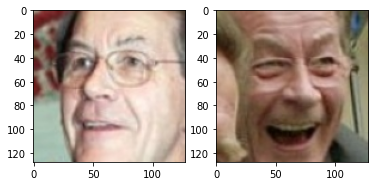

In [9]:
plotPair(pairs, 3000)

In [10]:
numPos = 0
numNeg = 0

for pair in pairs:
  if pair[2] == 1:
    numPos += 1
  else:
    numNeg += 1

print("Number of positive pairs:", numPos)
print("Number of negative pairs:", numNeg)

Number of positive pairs: 5062
Number of negative pairs: 5062


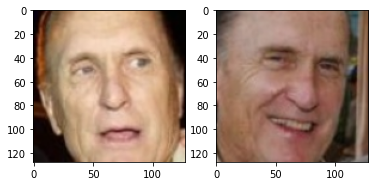

In [11]:
plotPair(pairs, 3)

#### Split Data

In [12]:
dataRaw = pairs
random.shuffle(dataRaw)

data_complement, data_test = train_test_split(dataRaw, train_size=.8, random_state=305)
data_train, data_valid = train_test_split(data_complement, train_size=.7, random_state=305)

random.shuffle(data_train)
random.shuffle(data_valid)
random.shuffle(data_test)

In [13]:
del dataRaw
del pairs
del data_complement
gc.collect()

8701

In [14]:
X_train = []
y_train = []

X_valid = []
y_valid = []

X_test = []
y_test = []

for i in range(len(data_train)):
  X_train.append([np.array(data_train[i][0]), np.array(data_train[i][1])])
  y_train.append(np.array(data_train[i][2]))

for i in range(len(data_valid)):
  X_valid.append([np.array(data_valid[i][0]), np.array(data_valid[i][1])])
  y_valid.append(np.array(data_valid[i][2]))

for i in range(len(data_test)):
  X_test.append([np.array(data_test[i][0]), np.array(data_test[i][1])])
  y_test.append(np.array(data_test[i][2]))

X_valid.pop()
y_valid.pop()

X_train = np.array(X_train)
y_train = np.array(y_train)

X_valid = np.array(X_valid)
y_valid = np.array(y_valid)

X_test = np.array(X_test)
y_test = np.array(y_test)

In [15]:
del data_train
del data_valid
del data_test
gc.collect()

50

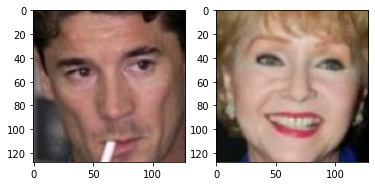

In [16]:
plotPair(X_train, 0)

## Model

#### Embedding Network

In [17]:
def makeEmbeddingNetwork():
  input = Input(shape=(dim, dim, 3), name='input_image')

  conv1 = Conv2D(72, (10, 10), activation='relu', padding='same')(input)
  pool1 = MaxPooling2D(64, (2, 2), padding='same')(conv1)
  
  conv2 = Conv2D(128, (7, 7), activation='relu', padding='same')(pool1)
  pool2 = MaxPooling2D(64, (2, 2), padding='same')(conv2)

  conv3 = Conv2D(128, (4, 4), activation='relu', padding='same', kernel_regularizer =tf.keras.regularizers.l2( l=0.01))(pool2)
  pool3 = MaxPooling2D(64, (2, 2), padding='same')(conv3)

  conv4 = Conv2D(256, (4, 4), activation='relu', padding='same', kernel_regularizer =tf.keras.regularizers.l2( l=0.01))(pool3)
  flat1 = Flatten()(conv4)
  dense1 = Dense(8192, activation='sigmoid')(flat1) # Embedding vector

  return(Model(inputs=[input], outputs=[dense1], name='embedding'))

In [18]:
embedding = makeEmbeddingNetwork()

In [19]:
embedding.summary()

Model: "embedding"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 128, 128, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 128, 128, 72)      21672     
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 72)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 128)       451712    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 32, 32, 128)      0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 128)       26

####Distance Functions

In [20]:
def euclidean_distance(vects): # Gives better accuracy than manhattan distance
    x, y = vects
    sum_square = tf.math.reduce_sum(tf.math.square(x - y), axis=1, keepdims=True)
    return(tf.math.sqrt(tf.math.maximum(sum_square, tf.keras.backend.epsilon())))

"""
def manhattan_distance(vects):
    x, y = vects
    sumOfDiff = tf.math.reduce_sum(x - y, axis=1, keepdims=True)
    return(tf.math.abs(tf.math.maximum(sumOfDiff, tf.keras.backend.epsilon())))

def cosine_similarity(vects):
  x, y = vects
  cos_sim = tf.tensordot(x, y, 0)/(tf.norm(x, axis=1, keepdims=True)*tf.norm(y, axis=1, keepdims=True))
  return(cos_sim)
"""

'\ndef manhattan_distance(vects):\n    x, y = vects\n    sumOfDiff = tf.math.reduce_sum(x - y, axis=1, keepdims=True)\n    return(tf.math.abs(tf.math.maximum(sumOfDiff, tf.keras.backend.epsilon())))\n\ndef cosine_similarity(vects):\n  x, y = vects\n  cos_sim = tf.tensordot(x, y, 0)/(tf.norm(x, axis=1, keepdims=True)*tf.norm(y, axis=1, keepdims=True))\n  return(cos_sim)\n'

#### Loss Functions

In [21]:
def contrastive_loss(y_true, y_pred):
  square_pred = tf.math.square(y_pred)
  margin_square = tf.math.square(tf.math.maximum(1 - (y_pred), 0))
  
  return(tf.math.reduce_mean(
      (1 - y_true) * square_pred + (y_true) * margin_square
  ))

"""
def contrastive_loss1(y_true, y_pred):
  square_pred = y_pred
  margin_square = tf.math.square(tf.math.maximum(1 - (y_pred), 0))
  
  return(tf.math.reduce_mean(
      (1 - y_true) * square_pred + (y_true) * margin_square
  ))
"""

def contrastive_loss2(y_true, y_pred):
  square_pred = tf.math.square(y_pred)
  margin_square = tf.math.maximum(1 - (y_pred), 0)
  
  return(tf.math.reduce_mean(
      (1 - y_true) * square_pred + (y_true) * margin_square
  ))

"""
def contrastive_loss3(y_true, y_pred):
  square_pred = y_pred
  margin_square = tf.math.maximum(1 - (y_pred), 0)
  
  return(tf.math.reduce_mean(
      (1 - y_true) * square_pred + (y_true) * margin_square
  ))
"""

'\ndef contrastive_loss3(y_true, y_pred):\n  square_pred = y_pred\n  margin_square = tf.math.maximum(1 - (y_pred), 0)\n  \n  return(tf.math.reduce_mean(\n      (1 - y_true) * square_pred + (y_true) * margin_square\n  ))\n'

#### Siamese Connection

In [22]:
def makeSiameseModel():

  img1 = Input(name='image_1', shape=(dim, dim, 3))

  img2 = Input(name='image_2', shape=(dim, dim, 3))

  distances = Lambda(euclidean_distance)([embedding(img1), embedding(img2)])
  normal_layer = BatchNormalization()(distances)
  classifier = Dense(1, activation="sigmoid")(normal_layer)

  return (Model(inputs=[img1, img2], outputs=classifier, name='SiameseNetwork'))

In [23]:
SiameseNetwork = makeSiameseModel()

In [24]:
SiameseNetwork.summary()

Model: "SiameseNetwork"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 image_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 image_2 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 embedding (Functional)         (None, 8192)         538139304   ['image_1[0][0]',                
                                                                  'image_2[0][0]']   

## Training

In [25]:
loss = contrastive_loss2
optimizer = tf.keras.optimizers.SGD(learning_rate=.01, momentum=.01)

SiameseNetwork.compile(loss=loss, optimizer=optimizer,
              metrics=[tf.keras.metrics.Precision()]) # Using precision because False Positives are detrimental

In [26]:
history = SiameseNetwork.fit(x = [X_train[:,0], X_train[:,1]], y = y_train.astype("float32"), validation_data = ([X_valid[:,0], X_valid[:,1]], y_valid.astype("float32")), epochs=100)

Epoch 1/100
178/178 [==============================] - 68s 367ms/step - loss: 3.2358 - precision: 0.6008 - val_loss: 3.1394 - val_precision: 0.6535
Epoch 2/100
178/178 [==============================] - 63s 355ms/step - loss: 3.0165 - precision: 0.6419 - val_loss: 2.9224 - val_precision: 0.6333
Epoch 3/100
178/178 [==============================] - 63s 352ms/step - loss: 2.8189 - precision: 0.6564 - val_loss: 2.7518 - val_precision: 0.5488
Epoch 4/100
178/178 [==============================] - 62s 349ms/step - loss: 2.6351 - precision: 0.6620 - val_loss: 2.5763 - val_precision: 0.5836
Epoch 5/100
178/178 [==============================] - 62s 347ms/step - loss: 2.4652 - precision: 0.6699 - val_loss: 2.3922 - val_precision: 0.6581
Epoch 6/100
178/178 [==============================] - 62s 348ms/step - loss: 2.3042 - precision: 0.6846 - val_loss: 2.2840 - val_precision: 0.5404
Epoch 7/100
178/178 [==============================] - 62s 347ms/step - loss: 2.1612 - precision: 0.6763 - val_l

## Results

In [27]:
test = 0
SiameseNetwork.predict([np.expand_dims(X_test[test][0], axis=0), np.expand_dims(X_test[test][1], axis=0)])

array([[0.99965596]], dtype=float32)

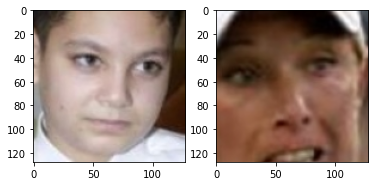

In [28]:
plotPair(X_test, test)

In [29]:
preds = SiameseNetwork.predict([X_test[:,0], X_test[:,1]])

In [30]:
for i in range(len(preds)):
  if preds[i][0] > .5: # .5 is an arbitrary threshold
    preds[i][0] = 1
  else:
    preds[i][0] = 0

In [31]:
preds = np.concatenate(preds, axis=0)

In [32]:
count = 0.0
correct = 0.0
for i in range(len(y_test)):
  count+=1
  if y_test[i]==preds[i]:
    correct+=1
print((correct/count)*100)

76.19753086419753


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


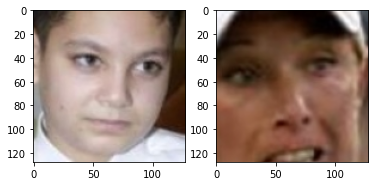

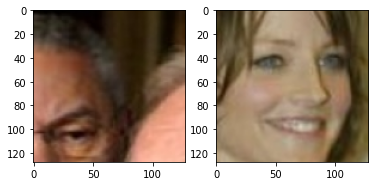

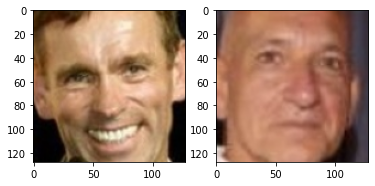

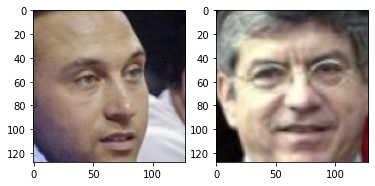

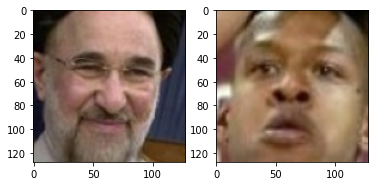

...

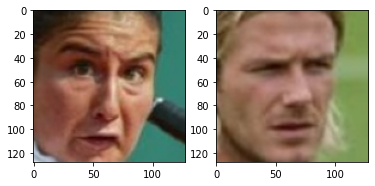

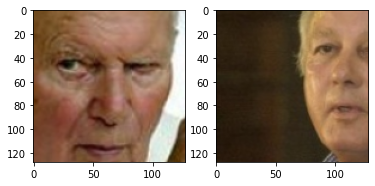

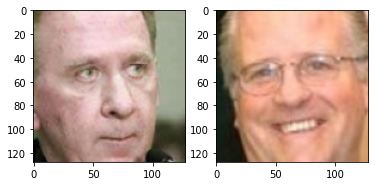

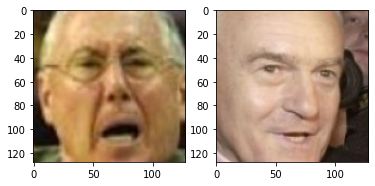

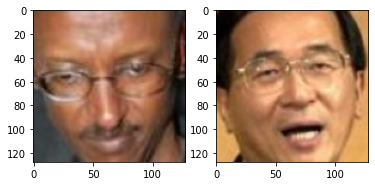

In [33]:
numWrong = 0

for i in range(len(y_test)):
  if y_test[i] != preds[i]:
    numWrong+=1
    if preds[i] == 1 and y_test[i] == 0:
      plotPair(X_test, i)

In [34]:
print("Total Wrong:", numWrong, "/", y_test.shape[0])

Total Wrong: 482 / 2025


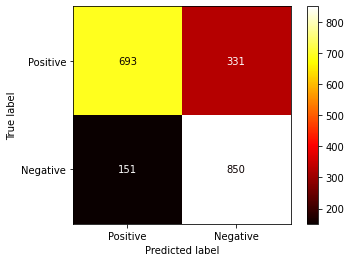

In [35]:
cm = confusion_matrix(y_test, preds)
display = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Positive', 'Negative'])
display.plot(cmap='hot')

In [36]:
SiameseNetwork.save('SiameseNetwork2')

In [37]:
import datetime as dt

# Save the current time to a variable ('t')
t = dt.datetime.now()

while True:
    delta = dt.datetime.now()-t
    if delta.seconds >= 60:
        print("1 Min")
        # Update 't' variable to new time
        t = dt.datetime.now()

1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min
1 Min


KeyboardInterrupt: ignored